In [ ]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 28.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=6ccf2e093f7accb7fa7e2df54932ab1463e704a807f10d42b4bcc771a63fbae3
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
torch:  1.10 ; cuda:  cu111
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 554 kB/s 
     |████████████████████████████████| 130 kB 28.0 MB/s 
     |████████████████████████████████| 50 kB 7.3 MB/s 
     |████████████████████████████████| 74 kB 4.0 MB/s 
     |████████████████████████████████| 145 kB 64.5 MB/s 
     |████████████████████████████████| 749 kB 58.9 MB/s 
     |██████████████████████████████

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random, pathlib, hashlib
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# Create annotations

### Function to extract image annotations in standard format expected by Detectron2

In [ ]:
def get_dataset_dict(dataset_dir):
  rootdir = pathlib.Path(dataset_dir)

  # find annotations
  json_files = [f for f in rootdir.glob('**/*') if f.is_file() if f.suffix == '.json']

  dataset_dicts = []
  for json_file in json_files:
    with open(json_file, 'r') as fp:
      img_anns = json.load(fp)

    record = {}
    dirname = os.path.dirname(os.path.abspath(json_file))
    filename = os.path.basename(img_anns['imagePath'])
    record['file_name'] = os.path.join(dirname, filename)
    record['height'] = img_anns['imageHeight']
    record['width'] = img_anns['imageWidth']
    record['image_id'] = hashlib.sha1(str(json_file).encode()).hexdigest()

    objs = []
    all_anns = img_anns['annotations']
    for anno in all_anns:
      obj = {
          "segmentation": anno['segmentation'],
          "bbox": anno['bbox'],
          "bbox_mode": BoxMode.XYXY_ABS,
          "category_id": 0, # only single class - quantum dot
          "iscrowd": 0
      }
      objs.append(obj)
    record['annotations'] = objs
    dataset_dicts.append(record)

  return dataset_dicts


### Register dataset

In [ ]:
train_data_path = '/content/gdrive/MyDrive/train'
dataset_dicts = get_dataset_dict(train_data_path)
classes = ['qd']
DatasetCatalog.register(
    "category_train",
    lambda: get_dataset_dict(train_data_path))

MetadataCatalog.get("category_train").set(thing_classes=classes)
metadata_controller = MetadataCatalog.get("category_train")

## Visualize and verify labels in our training dataset

/content/gdrive/MyDrive/train/405/0.5a.tif


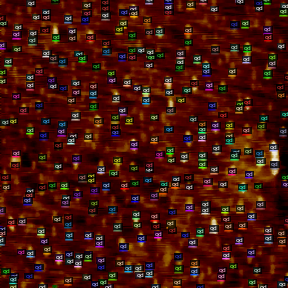

/content/gdrive/MyDrive/train/405/0.5b.tif


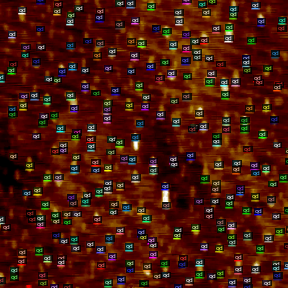

/content/gdrive/MyDrive/train/405/0.5c.tif


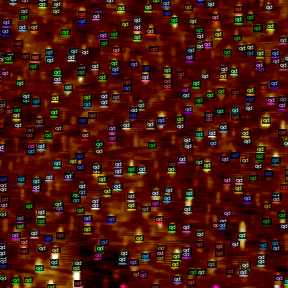

/content/gdrive/MyDrive/train/405/0.5d.tif


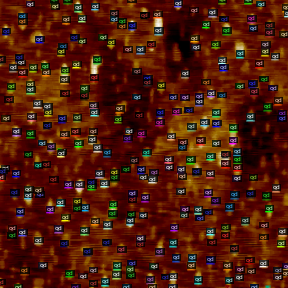

/content/gdrive/MyDrive/train/406/0.5a.tif


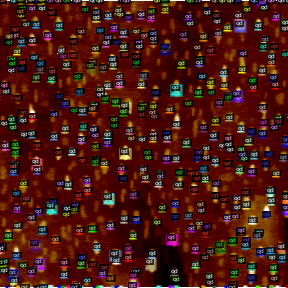

/content/gdrive/MyDrive/train/406/0.5b.tif


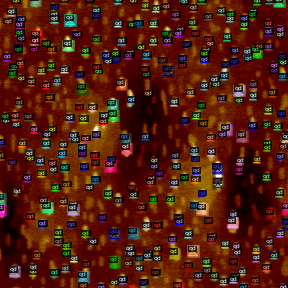

/content/gdrive/MyDrive/train/406/0.5c.tif


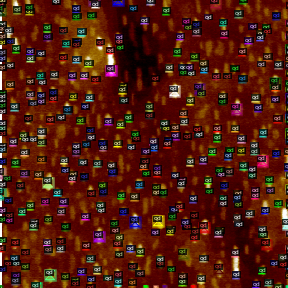

/content/gdrive/MyDrive/train/406/0.5d.tif


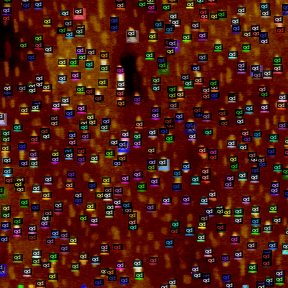

/content/gdrive/MyDrive/train/404/0.5a.tif


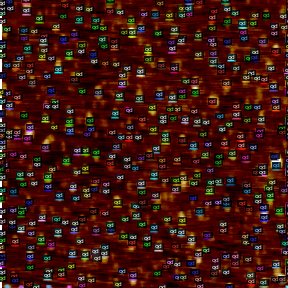

/content/gdrive/MyDrive/train/404/0.5b.tif


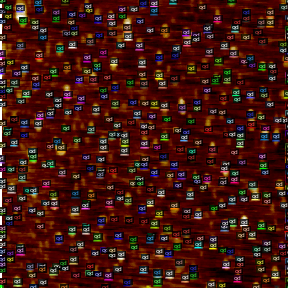

/content/gdrive/MyDrive/train/404/0.5c.tif


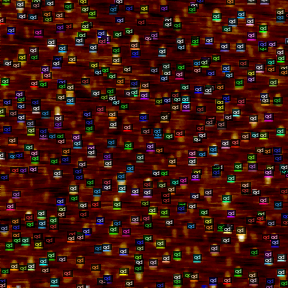

/content/gdrive/MyDrive/train/404/0.5d.tif


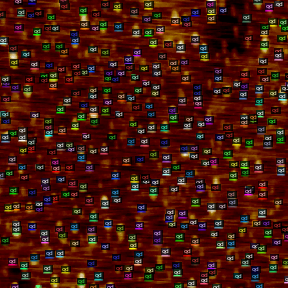

/content/gdrive/MyDrive/train/86/2a.tif


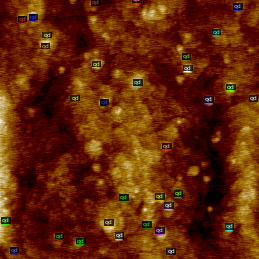

/content/gdrive/MyDrive/train/86/2b.tif


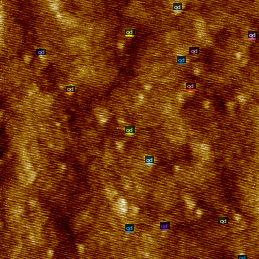

/content/gdrive/MyDrive/train/86/2c.tif


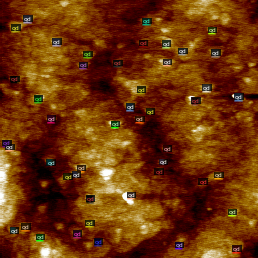

/content/gdrive/MyDrive/train/86/2d.tif


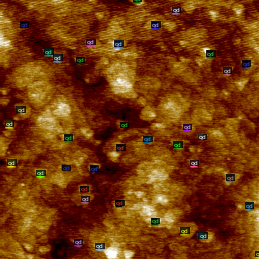

/content/gdrive/MyDrive/train/86/2e.tif


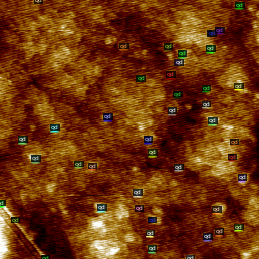

/content/gdrive/MyDrive/train/86/2f.tif


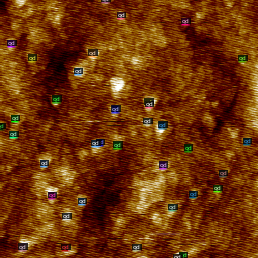

/content/gdrive/MyDrive/train/86/2g.tif


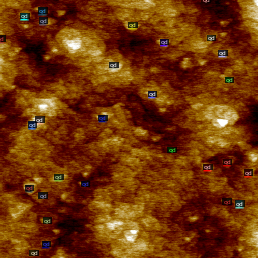

/content/gdrive/MyDrive/train/86/2h.tif


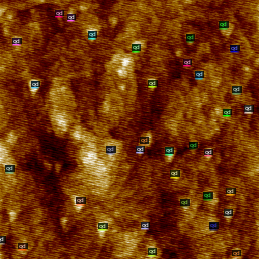

/content/gdrive/MyDrive/train/86/2i.tif


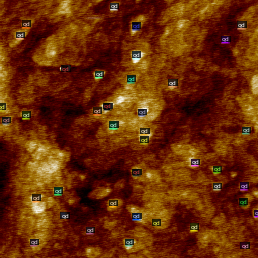

/content/gdrive/MyDrive/train/86/2j.tif


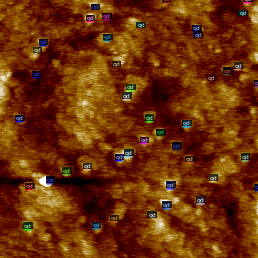

/content/gdrive/MyDrive/train/86/2k.tif


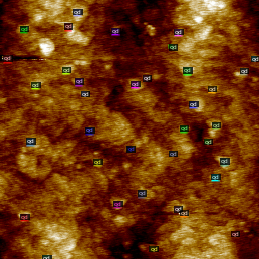

/content/gdrive/MyDrive/train/86/2l.tif


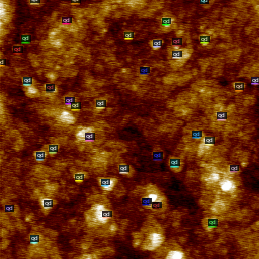

/content/gdrive/MyDrive/train/86/2m.tif


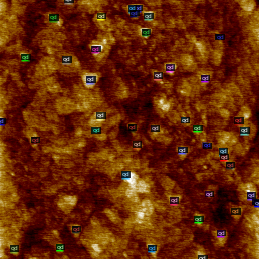

/content/gdrive/MyDrive/train/86/2n.tif


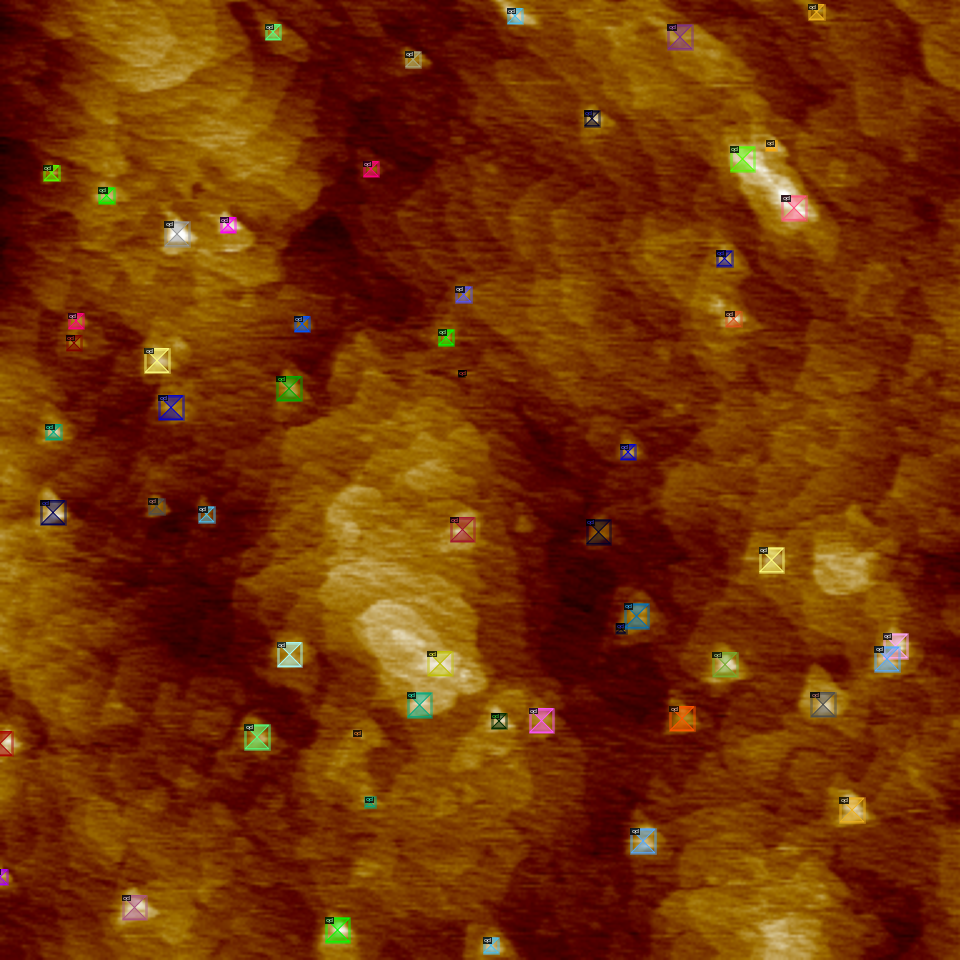

/content/gdrive/MyDrive/train/86/2o.tif


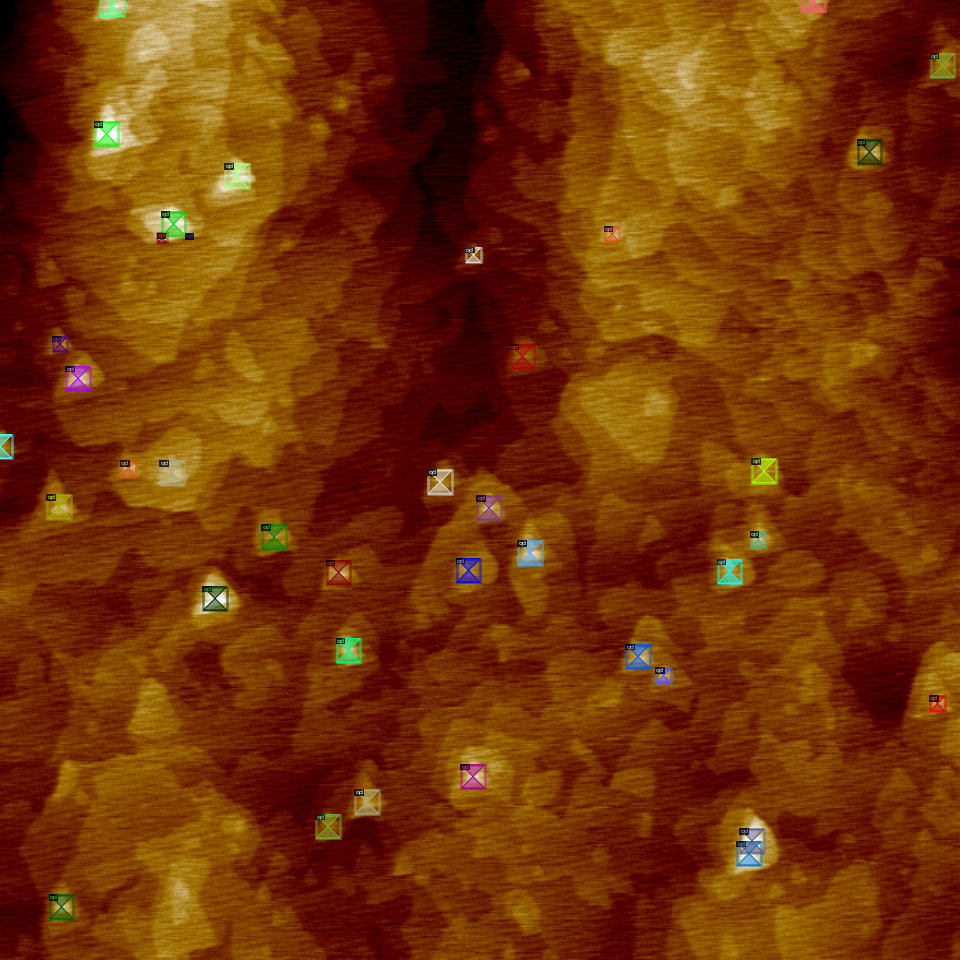

/content/gdrive/MyDrive/train/86/2p.tif


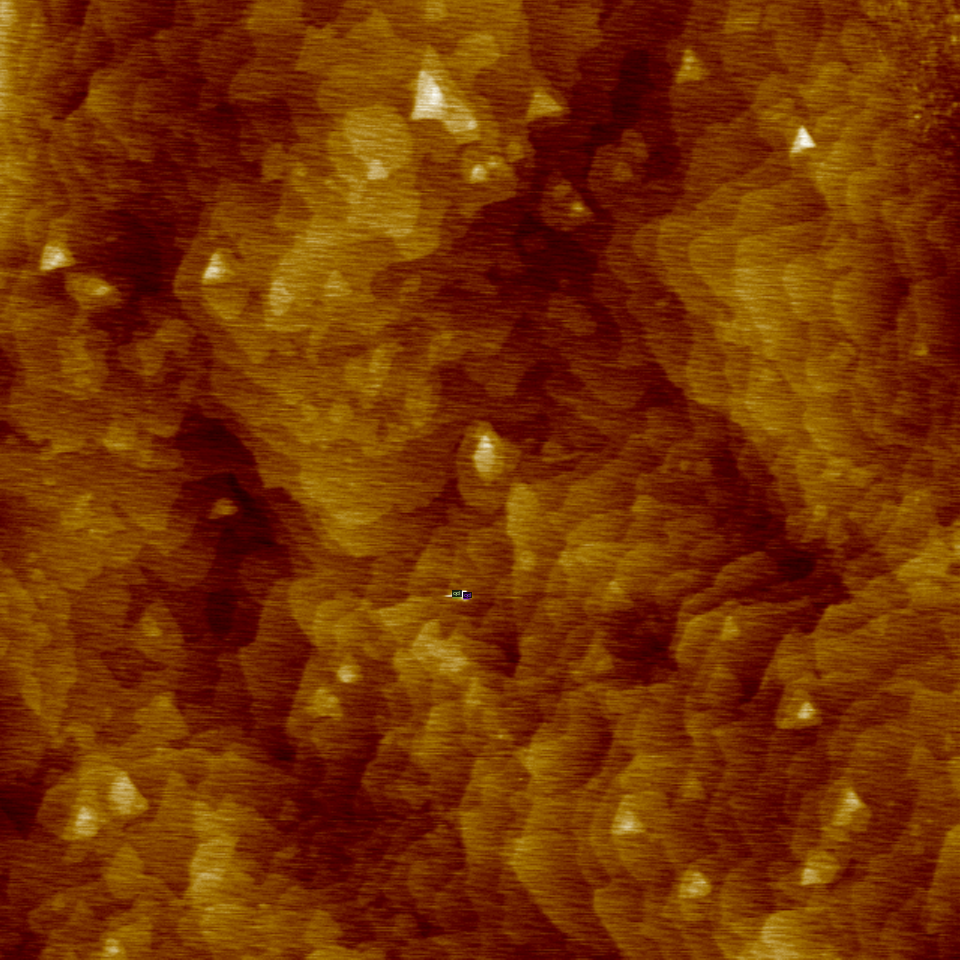

/content/gdrive/MyDrive/train/86/2q.tif


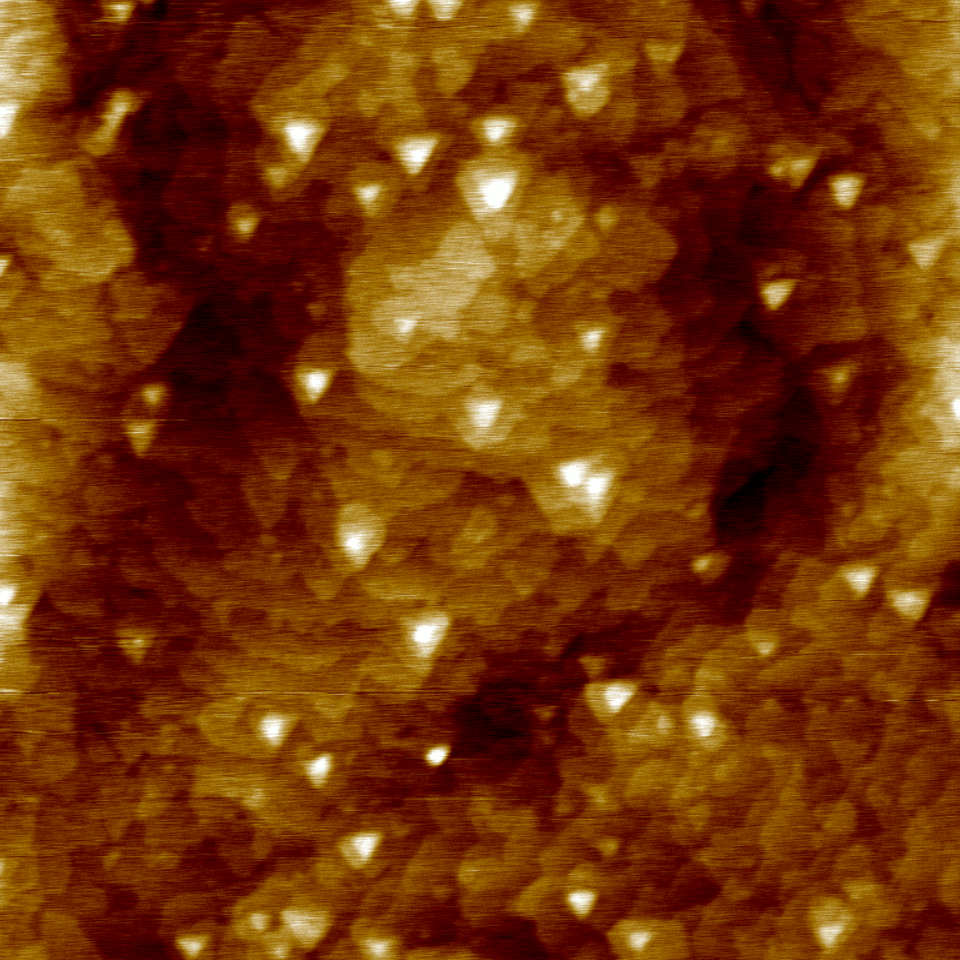

/content/gdrive/MyDrive/train/87/2a.tif


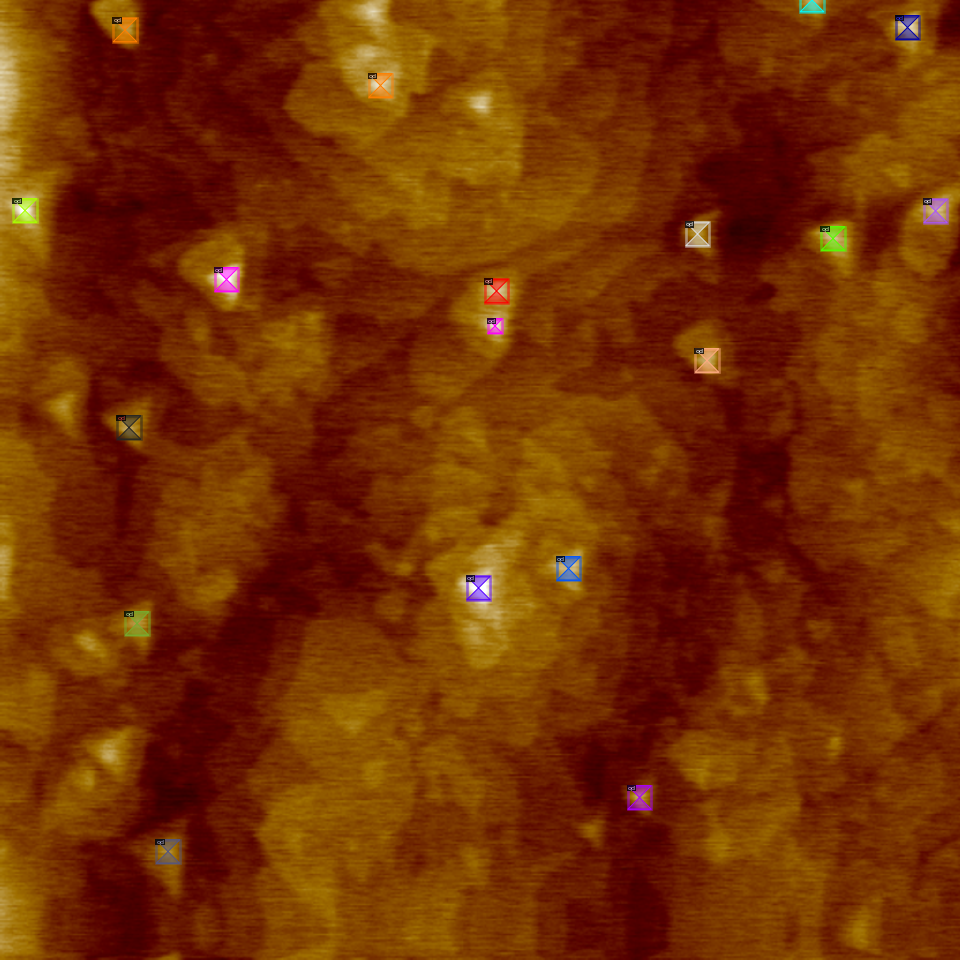

/content/gdrive/MyDrive/train/87/2b.tif


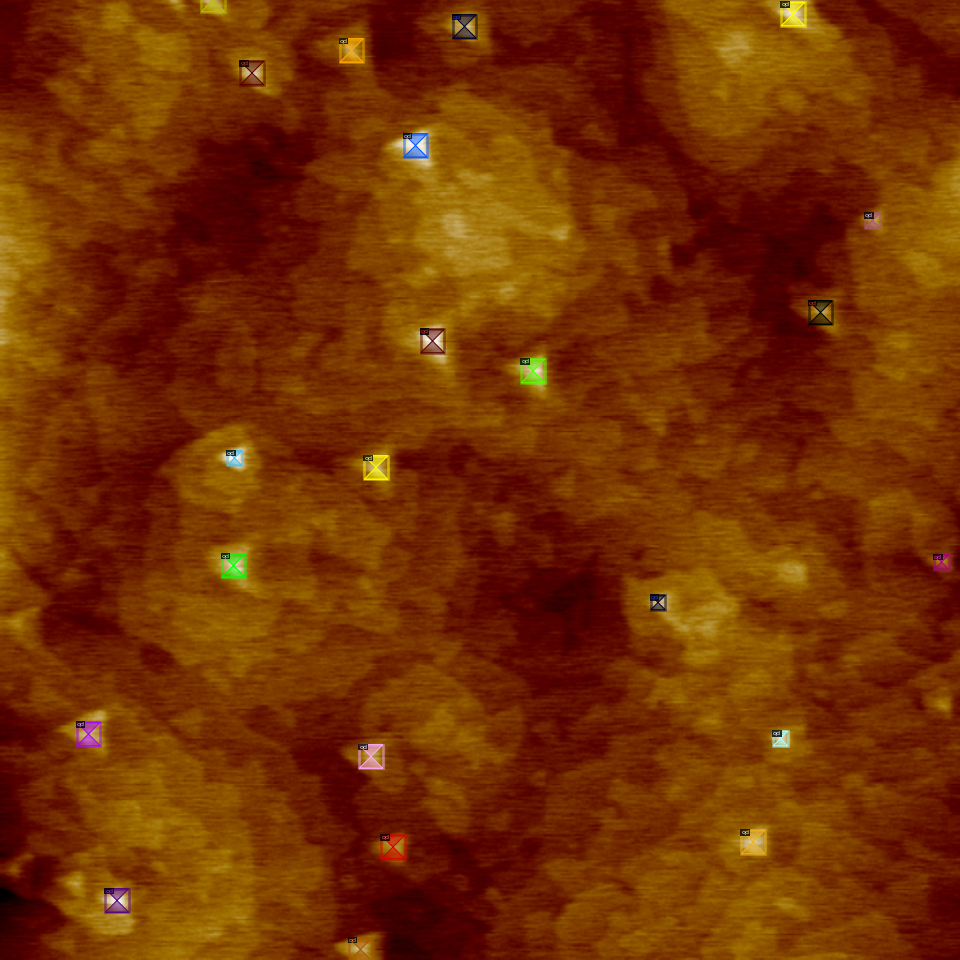

/content/gdrive/MyDrive/train/87/2c.tif


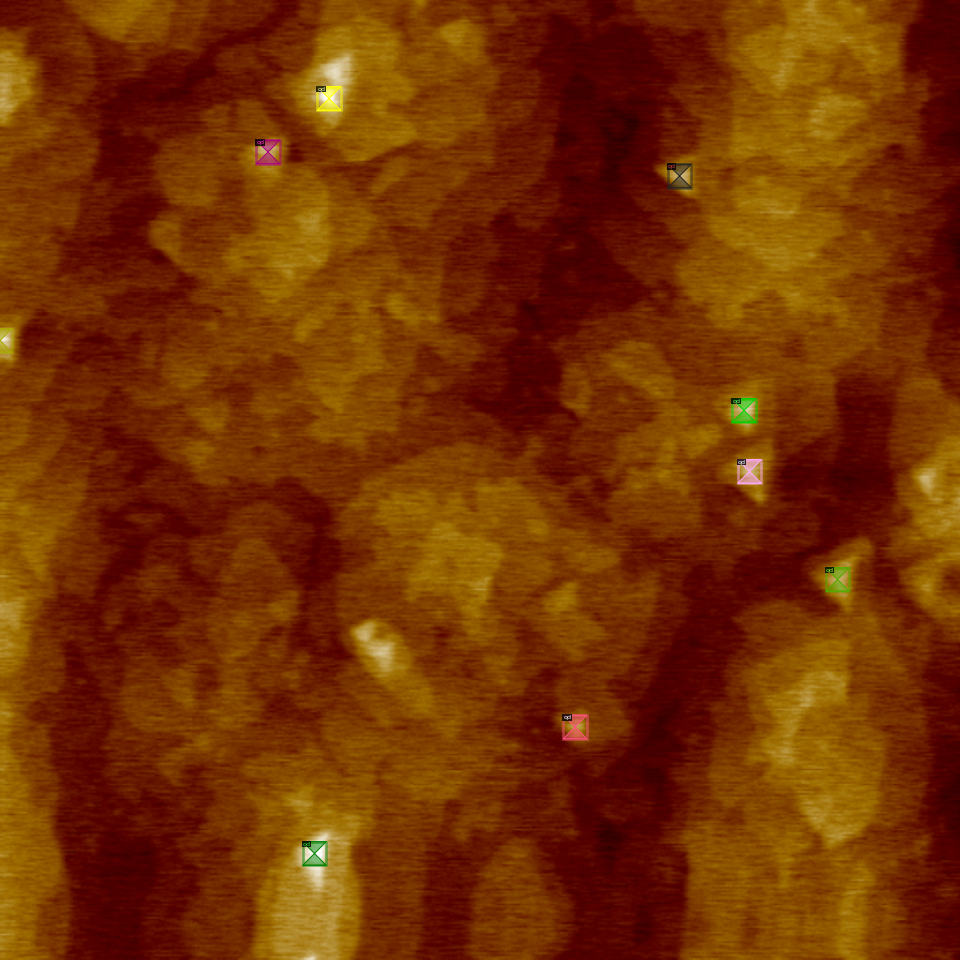

/content/gdrive/MyDrive/train/87/2d.tif


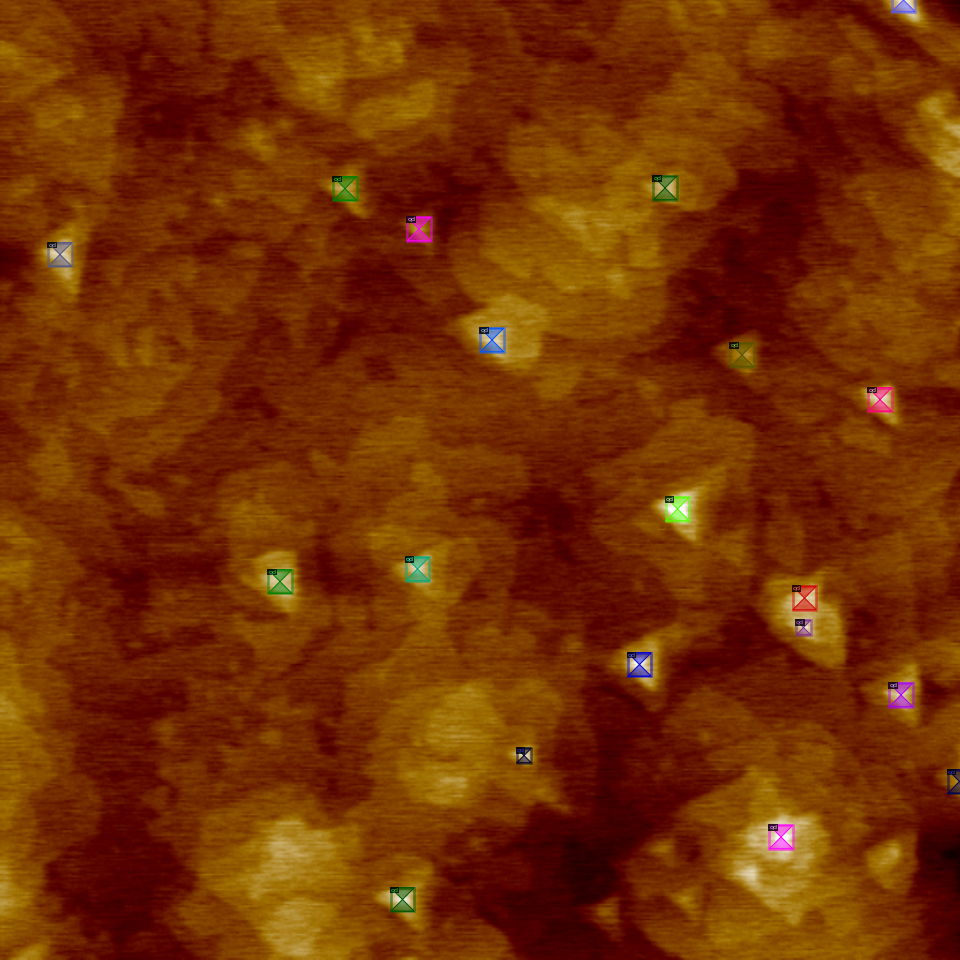

/content/gdrive/MyDrive/train/87/2e.tif


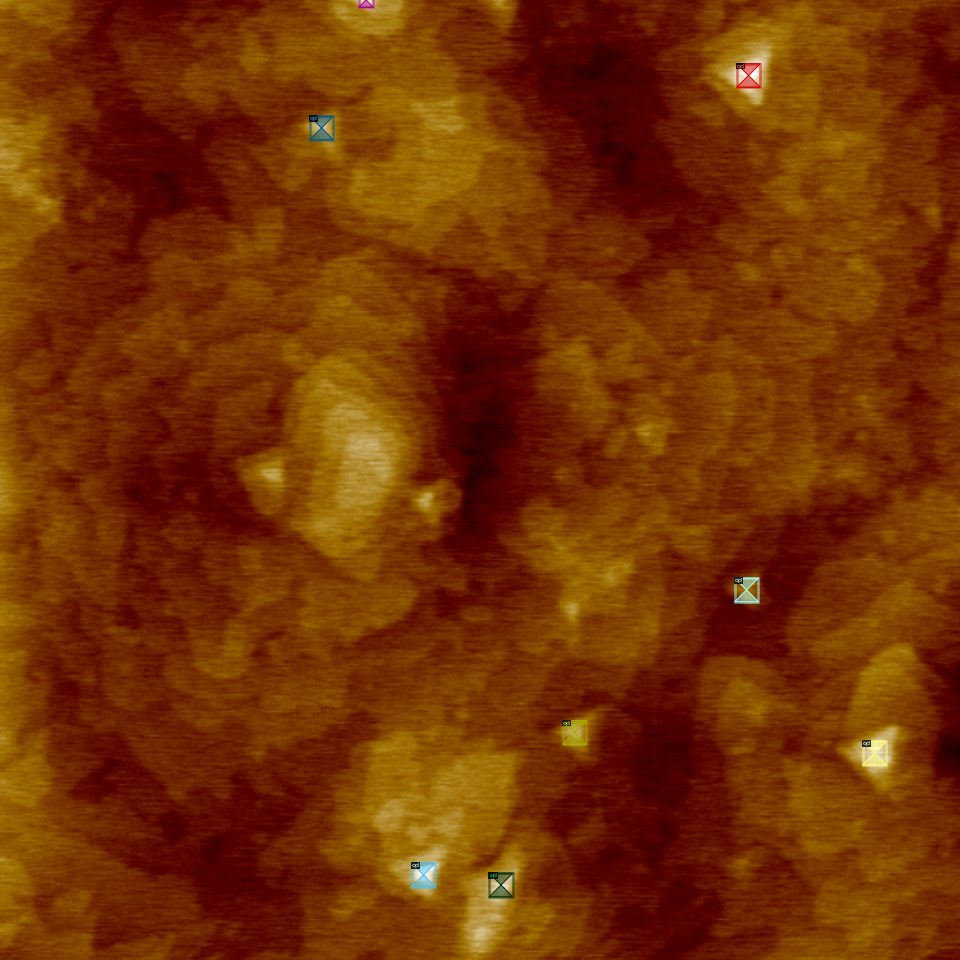

/content/gdrive/MyDrive/train/87/2f.tif


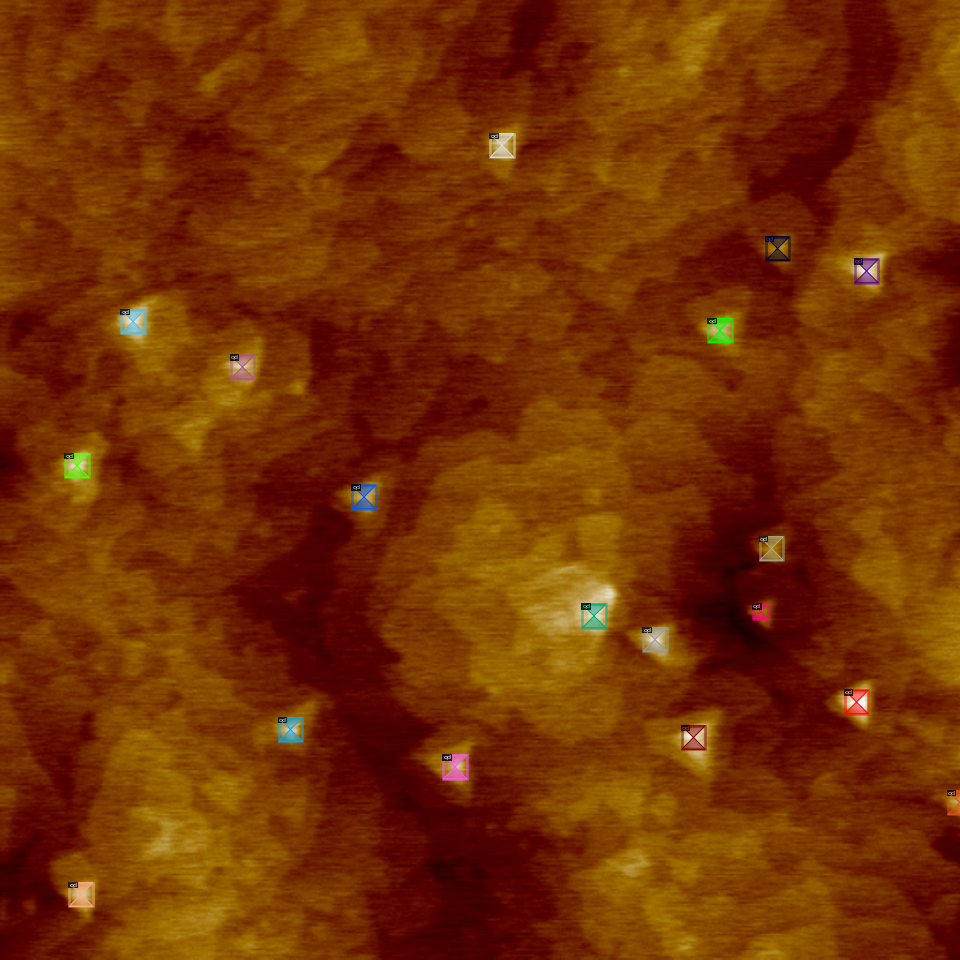

/content/gdrive/MyDrive/train/87/2g.tif


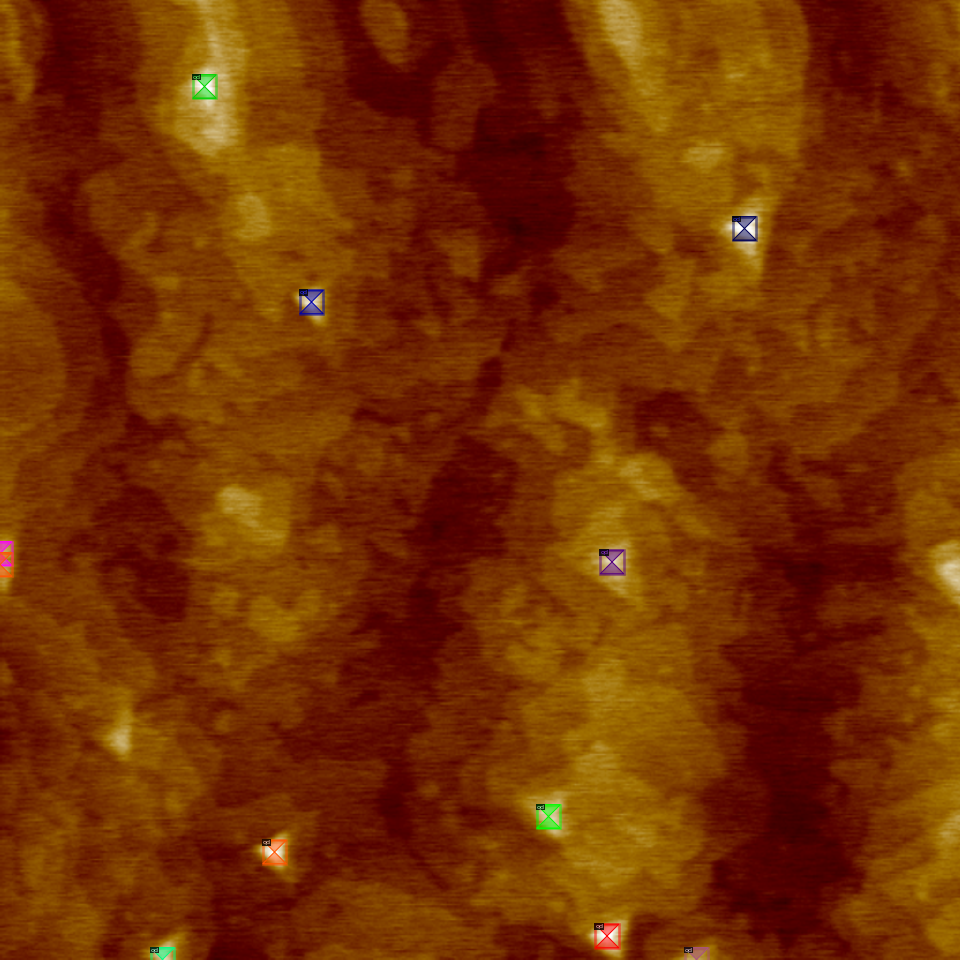

/content/gdrive/MyDrive/train/87/2h.tif


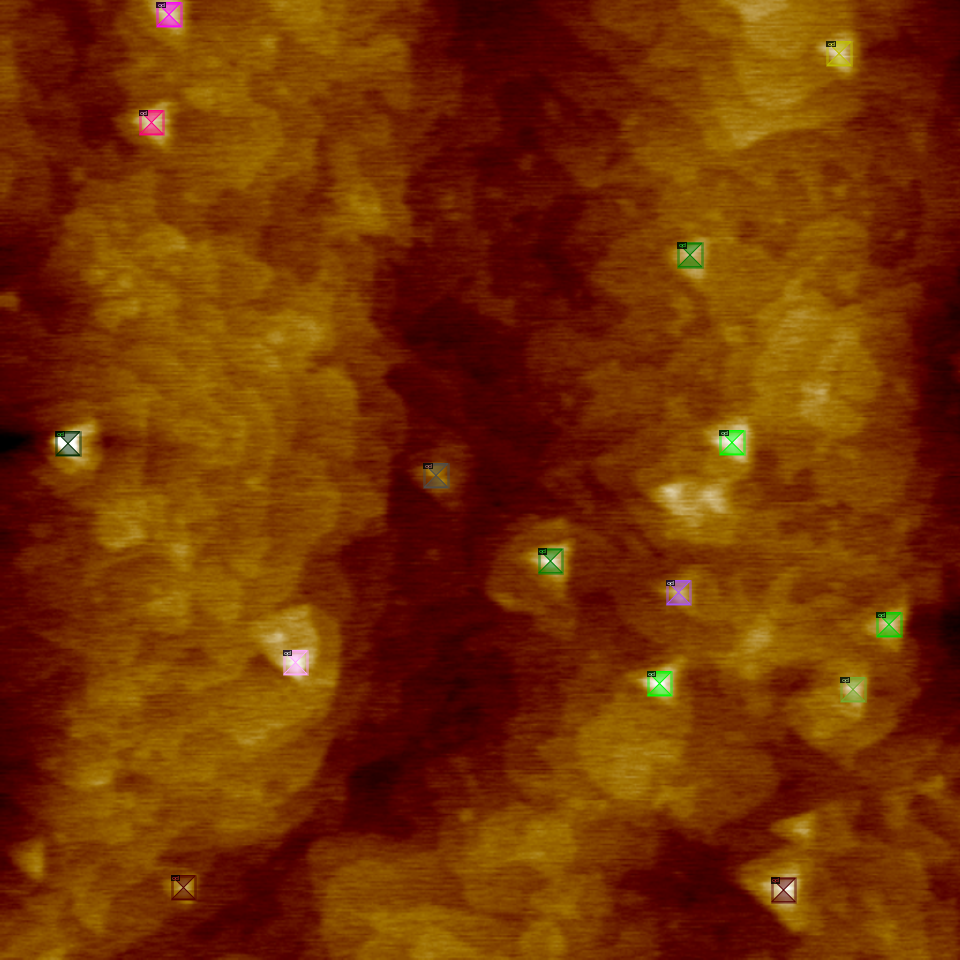

/content/gdrive/MyDrive/train/87/2i.tif


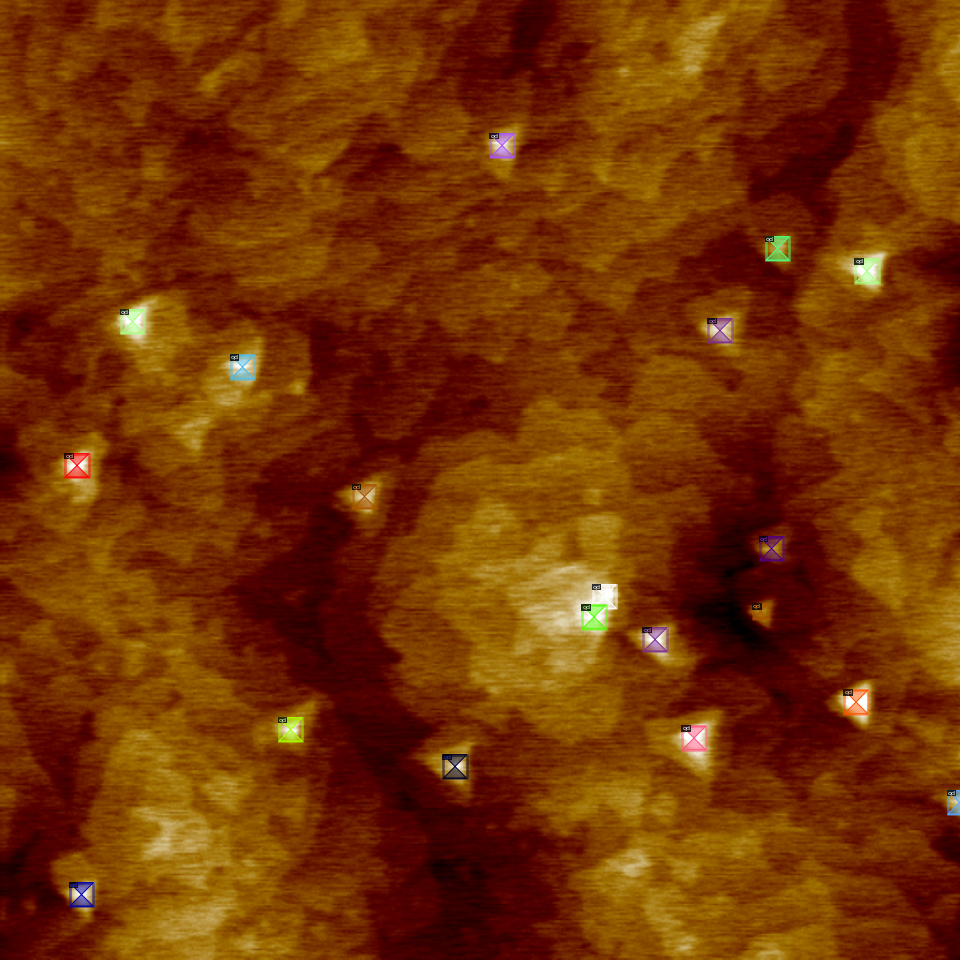

/content/gdrive/MyDrive/train/87/5a.tif


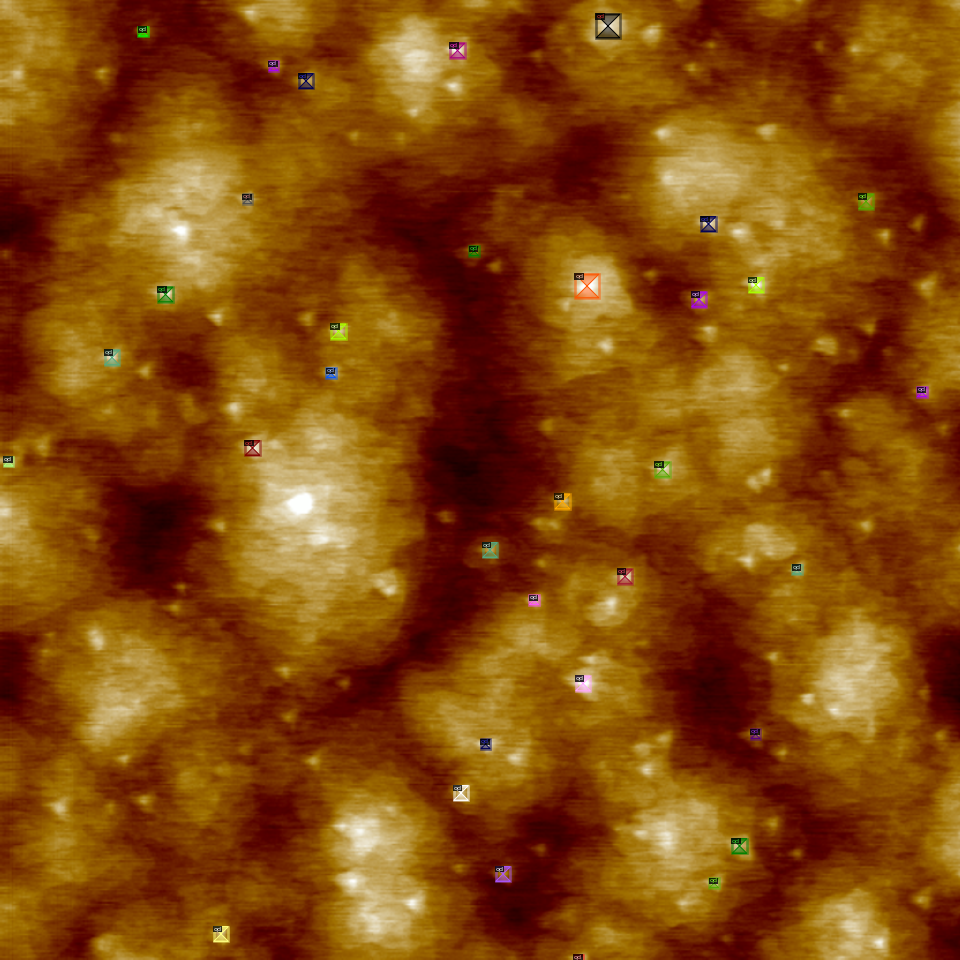

/content/gdrive/MyDrive/train/132/2a.tif


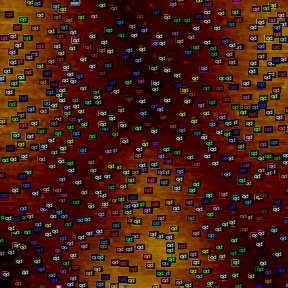

/content/gdrive/MyDrive/train/132/2c.tif


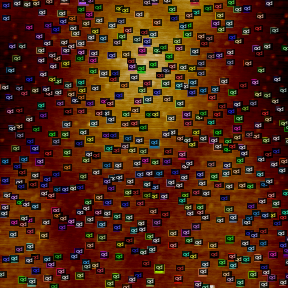

/content/gdrive/MyDrive/train/157/2a.tif


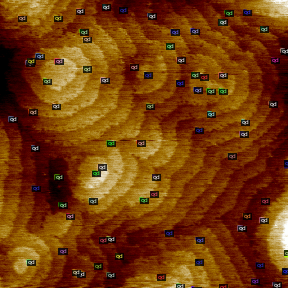

/content/gdrive/MyDrive/train/157/5a.tif


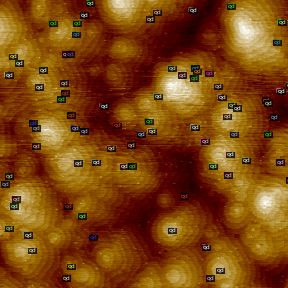

/content/gdrive/MyDrive/train/107/1a.tif


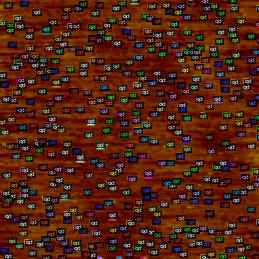

/content/gdrive/MyDrive/train/107/1b.tif


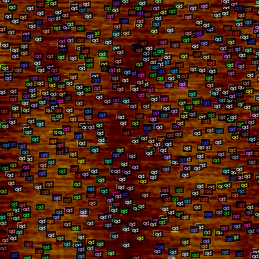

/content/gdrive/MyDrive/train/107/2b.tif


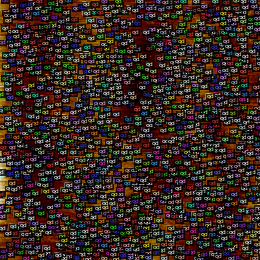

/content/gdrive/MyDrive/train/107/5a.tif


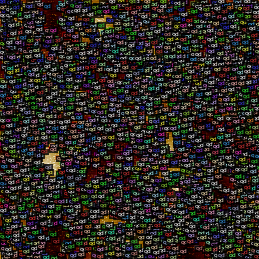

/content/gdrive/MyDrive/train/106/1a.tif


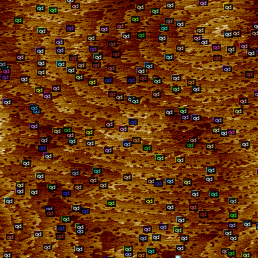

/content/gdrive/MyDrive/train/106/1b.tif


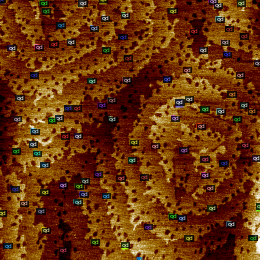

/content/gdrive/MyDrive/train/106/2a.tif


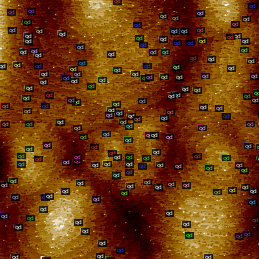

/content/gdrive/MyDrive/train/106/2b.tif


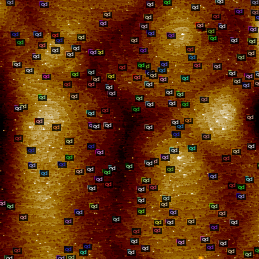

/content/gdrive/MyDrive/train/106/2c.tif


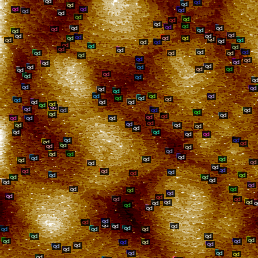

/content/gdrive/MyDrive/train/106/5a.tif


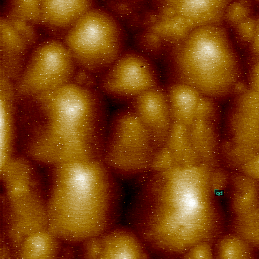

/content/gdrive/MyDrive/train/32/5a.tif


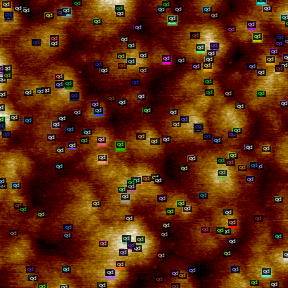

/content/gdrive/MyDrive/train/32/5b.tif


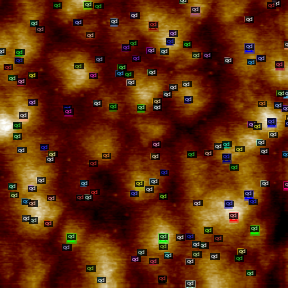

In [ ]:
for d in dataset_dicts: #random.sample(dataset_dicts, 5):
    img = cv2.imread(d["file_name"])
    print(d['file_name'])
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata_controller, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

### Training Instance Segmentation model

In [ ]:
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import ColorMode, Visualizer

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_C4_1x.yaml"))
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("category_train",)
cfg.DATALOADER.NUM_WORKERS = 1
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_C4_1x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
# cfg.MODEL.DEVICE='cpu' 

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)

[04/05 19:41:30 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_721ade.pkl: 136MB [00:09, 15.1MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 2048) in the checkpoint but (2, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 2048) in the checkpoint but (4, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_pre

In [ ]:
trainer.train()

[04/05 19:41:45 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[04/05 19:42:37 d2.utils.events]:  eta: 0:42:09  iter: 19  total_loss: 2.372  loss_cls: 0.7442  loss_box_reg: 0.06256  loss_rpn_cls: 1.039  loss_rpn_loc: 0.468  time: 2.5841  data_time: 0.0322  lr: 4.9953e-06  max_mem: 9878M
[04/05 19:43:31 d2.utils.events]:  eta: 0:42:29  iter: 39  total_loss: 2.6  loss_cls: 0.6723  loss_box_reg: 0.09753  loss_rpn_cls: 1.287  loss_rpn_loc: 0.5989  time: 2.6398  data_time: 0.0116  lr: 9.9902e-06  max_mem: 9878M
[04/05 19:44:27 d2.utils.events]:  eta: 0:42:03  iter: 59  total_loss: 1.852  loss_cls: 0.6155  loss_box_reg: 0.2374  loss_rpn_cls: 0.485  loss_rpn_loc: 0.4522  time: 2.6872  data_time: 0.0151  lr: 1.4985e-05  max_mem: 9878M
[04/05 19:45:23 d2.utils.events]:  eta: 0:41:51  iter: 79  total_loss: 1.312  loss_cls: 0.5497  loss_box_reg: 0.2802  loss_rpn_cls: 0.2069  loss_rpn_loc: 0.2618  time: 2.7229  data_time: 0.0127  lr: 1.998e-05  max_mem: 9878M
[04/05 19:46:21 d2.utils.events]:  eta: 0:41:40  iter: 99  total_loss: 1.285  loss_cls: 0.4897  loss_

FileNotFoundError: ignored

### Inference using the Trained Model

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.0
cfg.DATASETS.TEST = ("category_test", )
predictor = DefaultPredictor(cfg)
test_data_path = '/content/gdrive/MyDrive/test'

In [ ]:
test_dataset_dicts = get_dataset_dict(test_data_path)

Filename: /content/gdrive/MyDrive/test/132/2b.tif
Number of quantum dots: 100


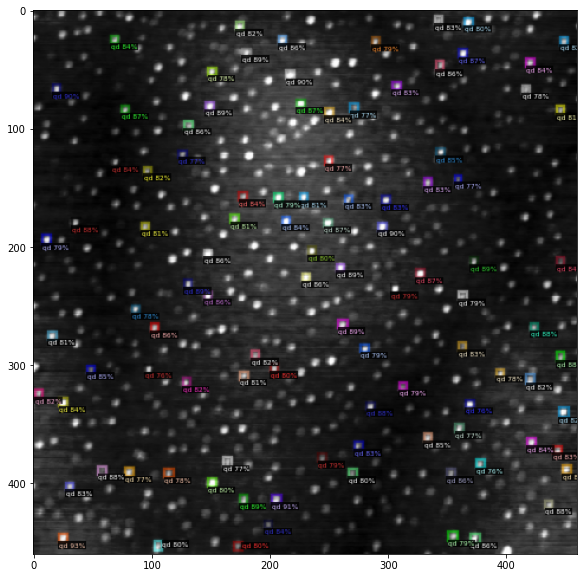

Filename: /content/gdrive/MyDrive/test/107/2a.tif
Number of quantum dots: 100


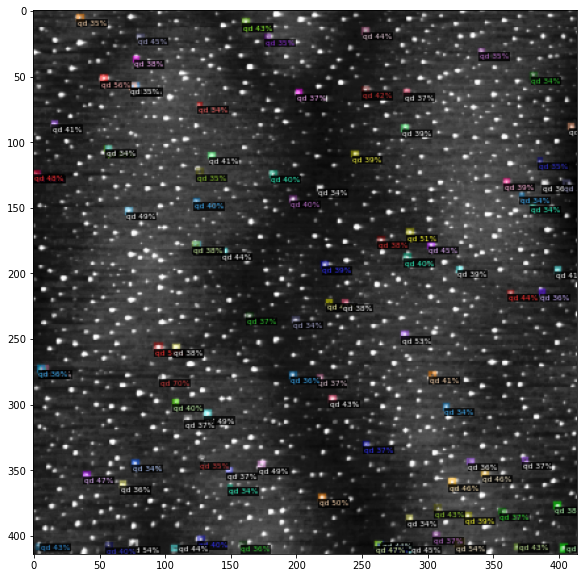

In [ ]:
import matplotlib.pyplot as plt
for d in test_dataset_dicts: 
    filename = d["file_name"]   
    img = cv2.imread(filename)
    outputs = predictor(img)
    num_dots = len(outputs["instances"].to("cpu"))
    print(f"Filename: {filename}")
    print(f'Number of quantum dots: {num_dots}')
    v = Visualizer(img[:, :, ::-1],
                   metadata=metadata_controller, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW # removes the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()